<a href="https://colab.research.google.com/github/azzindani/01_Depth_EDA/blob/main/EDA_Lookup_v1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Version 20240526

## 00 Importing Modules & Mounting Drive

In [ ]:
!pip install streamlit
!npm install localtunnel
!pip install ydata-profiling
!pip install sweetviz
!pip install autoviz
!pip install lux-api
!pip install dtale
!pip install dabl
!pip install dataprep
!pip install klib
!pip install missingno
!pip install klib


up to date, audited 23 packages in 890ms

3 packages are looking for funding
  run `npm fund` for details

2 moderate severity vulnerabilities

To address all issues (including breaking changes), run:
  npm audit fix --force

Run `npm audit` for details.
  Using cached pydantic-2.8.2-py3-none-any.whl.metadata (125 kB)
Using cached pydantic-2.8.2-py3-none-any.whl (423 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.0/13.0 MB 14.6 MB/s eta 0:00:00
  Attempting uninstall: pydantic
    Found existing installation: pydantic 1.10.18
    Uninstalling pydantic-1.10.18:
      Successfully uninstalled pydantic-1.10.18
  Attempting uninstall: pandas
    Found existing installation: pandas 1.5.3
    Uninstalling pandas-1.5.3:
      Successfully uninstalled pandas-1.5.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bigframes 1.15.0 requires sqlalchemy<3.0dev,>=1.4, bu

In [ ]:
import pathlib
import datetime
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
import os
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import sweetviz as sv
import dtale
import dtale.app as dtale_app
import dabl
import klib
import missingno as msno

from dataprep.eda import plot, plot_correlation, plot_missing
from google.colab import output
from google.colab import files
from ydata_profiling import ProfileReport
#from autoviz import AutoViz_Class
from tabulate import tabulate
from time import sleep

%matplotlib inline

In [ ]:
'''from google.colab import drive
drive.mount('/content/drive') #'''

"from google.colab import drive\ndrive.mount('/content/drive') #"

In [ ]:
'''MAIN_PATH = str(pathlib.Path().resolve())
WORK_PATH = MAIN_PATH + '/drive/MyDrive/Workspace'
SOURCE_PATH = WORK_PATH + '/00_Data_Source'
CACHE_PATH = WORK_PATH + '/00_Cache_Data' #'''

"MAIN_PATH = str(pathlib.Path().resolve())\nWORK_PATH = MAIN_PATH + '/drive/MyDrive/Workspace'\nSOURCE_PATH = WORK_PATH + '/00_Data_Source'\nCACHE_PATH = WORK_PATH + '/00_Cache_Data' #"

## 01 Choosing & Importing Dataset

### 01.01 Importing Main Data

In [ ]:
dataset_path = 'https://raw.githubusercontent.com/azzindani/00_Data_Source/main/Adidas_US_Sales.csv' # replace this

df = pd.read_csv(dataset_path, encoding = 'ISO-8859-1')#, sep = ';')
df.shape

(9648, 13)

In [ ]:
df.nunique()

,0
Retailer,6
Retailer ID,4
Invoice Date,724
Region,5
State,50
City,52
Product,6
Price per Unit,139
Units Sold,361
Total Sales,3464


In [ ]:
df.head(2)

,Retailer,Retailer ID,Invoice Date,Region,State,City,Product,Price per Unit,Units Sold,Total Sales,Operating Profit,Operating Margin,Sales Method
0,Foot Locker,1185732,2020-01-01,Northeast,New York,New York,Men's Street Footwear,50.0,1200,600000.0,300000.0,0.5,In-store
1,Foot Locker,1185732,2020-01-02,Northeast,New York,New York,Men's Athletic Footwear,50.0,1000,500000.0,150000.0,0.3,In-store


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9648 entries, 0 to 9647
Data columns (total 13 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Retailer          9648 non-null   object 
 1   Retailer ID       9648 non-null   int64  
 2   Invoice Date      9648 non-null   object 
 3   Region            9648 non-null   object 
 4   State             9648 non-null   object 
 5   City              9648 non-null   object 
 6   Product           9648 non-null   object 
 7   Price per Unit    9648 non-null   float64
 8   Units Sold        9648 non-null   int64  
 9   Total Sales       9648 non-null   float64
 10  Operating Profit  9648 non-null   float64
 11  Operating Margin  9648 non-null   float64
 12  Sales Method      9648 non-null   object 
dtypes: float64(4), int64(2), object(7)
memory usage: 980.0+ KB


### 01.02 Importing Geo Data

In [ ]:
geo_path = 'https://raw.githubusercontent.com/PublicaMundi/MappingAPI/master/data/geojson/us-states.json' # replace this

gdf = gpd.read_file(geo_path)
gdf.head(2) #'''

,id,name,density,geometry
0,01,Alabama,94.650,"POLYGON ((-87.35930 35.00118, -85.60667 34.984..."
1,02,Alaska,1.264,"MULTIPOLYGON (((-131.60202 55.11798, -131.5691..."


In [ ]:
gdf = gdf.rename(columns = {'name' : 'State'})
gdf = gdf[['State', 'geometry']]
gdf.head(2)

,State,geometry
0,Alabama,"POLYGON ((-87.35930 35.00118, -85.60667 34.984..."
1,Alaska,"MULTIPOLYGON (((-131.60202 55.11798, -131.5691..."


### 01.03 Importing Additional Data (for enrichment)

## 02 Data Structuring

### 02.01 Selecting & Dropping Variables

In [ ]:
column_list = [] # fill this

df = df.drop(column_list, axis = 1)
df.head(2) #'''

,Retailer,Retailer ID,Invoice Date,Region,State,City,Product,Price per Unit,Units Sold,Total Sales,Operating Profit,Operating Margin,Sales Method
0,Foot Locker,1185732,2020-01-01,Northeast,New York,New York,Men's Street Footwear,50.0,1200,600000.0,300000.0,0.5,In-store
1,Foot Locker,1185732,2020-01-02,Northeast,New York,New York,Men's Athletic Footwear,50.0,1000,500000.0,150000.0,0.3,In-store


### 02.02 Cleaning Text Object

#### 02.02.01 Convert Header to Proper Text

In [ ]:
for x in df.columns:
  y = x.title()
  df = df.rename(columns = {x : y}) #'''

#### 02.02.02 Strip Abnormal Spaces

In [ ]:
for x in df.columns:
  if df[x].dtypes == 'object':
    try:
      df[x] = df[x].str.strip()
    except:
      pass #'''

#### 02.02.03 Convert Object Content to Proper Text

In [ ]:
for x in df.columns:
  if df[x].dtypes == 'object':
    for a in df[x].unique():
      b = a.title()
      df[x] = df[x].replace(a, b)
  else:
    pass #'''

### 02.03 Coverting Data

#### 02.03.01 Convert to date

In [ ]:
df.head(2)

,Retailer,Retailer Id,Invoice Date,Region,State,City,Product,Price Per Unit,Units Sold,Total Sales,Operating Profit,Operating Margin,Sales Method
0,Foot Locker,1185732,2020-01-01,Northeast,New York,New York,Men'S Street Footwear,50.0,1200,600000.0,300000.0,0.5,In-Store
1,Foot Locker,1185732,2020-01-02,Northeast,New York,New York,Men'S Athletic Footwear,50.0,1000,500000.0,150000.0,0.3,In-Store


In [ ]:
column_list = ['Activity Period Start Date'] # fill this

for x in column_list:
  try:
    df[x] = pd.to_datetime(df[x])
  except:
    pass #'''

#### 02.03.02 Convert to integer

In [ ]:
column_list = [] # fill this

for x in column_list:
  df[x] = df[x].astype('int') #'''

#### 02.03.03 Convert to Object (if necessary)

In [ ]:
column_list = [] # fill this

for x in column_list:
  df[x] = df[x].astype('str') #'''

#### 02.03.04 Replace 0 to Nan (if necessary)

In [ ]:
#df = df.replace(0, np.nan)

## 03 Data Cleaning

### 03.01 Replacing Variable Component

In [ ]:
'''value_dict = {} # fill this

column_name = ''

df[column_name] = df[column_name].replace(value_dict) #'''

"value_dict = {} # fill this\n\ncolumn_name = ''\n\ndf[column_name] = df[column_name].replace(value_dict) #"

### 03.02 Add New Variable

#### 03.02.01 Add by Math Calculation

In [ ]:
'''new_var = '' # fill this
obj_var1 = '' # fill this
obj_var2 = '' # fill this

df[new_var] = df[obj_var1] * df [obj_var2] #'''

"new_var = '' # fill this\nobj_var1 = '' # fill this\nobj_var2 = '' # fill this\n\ndf[new_var] = df[obj_var1] * df [obj_var2] #"

#### 03.02.02 Add by Replacing "Other"

In [ ]:
'''column_name = '' # fill this

df[column_name].value_counts() #'''

"column_name = '' # fill this\n\ndf[column_name].value_counts() #"

In [ ]:
'''value_thres = 1300

replace_list = []

df_dict = df[column_name].value_counts().to_dict()
for i in df_dict:
  if df_dict[i] < value_thres:
    replace_list.append(i)

replace_list #'''

'value_thres = 1300\n\nreplace_list = []\n\ndf_dict = df[column_name].value_counts().to_dict()\nfor i in df_dict:\n  if df_dict[i] < value_thres:\n    replace_list.append(i)\n\nreplace_list #'

In [ ]:
'''df[column_name] = df[column_name].copy().replace(to_replace = replace_list, value = 'Other') #'''

"df[column_name] = df[column_name].copy().replace(to_replace = replace_list, value = 'Other') #"

### 03.03 Inaccuracies

In [ ]:
column_list = [] # fill this

for x in column_list:
  try:
    df[x] = df[x].replace('0', np.nan)
    df = df.dropna()
  except:
    pass

### 03.04 Handling Outliers
##### Data Distribution Check (Before)

In [ ]:
df.head(2)

,Retailer,Retailer Id,Invoice Date,Region,State,City,Product,Price Per Unit,Units Sold,Total Sales,Operating Profit,Operating Margin,Sales Method
0,Foot Locker,1185732,2020-01-01,Northeast,New York,New York,Men'S Street Footwear,50.0,1200,600000.0,300000.0,0.5,In-Store
1,Foot Locker,1185732,2020-01-02,Northeast,New York,New York,Men'S Athletic Footwear,50.0,1000,500000.0,150000.0,0.3,In-Store


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9648 entries, 0 to 9647
Data columns (total 13 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Retailer          9648 non-null   object 
 1   Retailer Id       9648 non-null   int64  
 2   Invoice Date      9648 non-null   object 
 3   Region            9648 non-null   object 
 4   State             9648 non-null   object 
 5   City              9648 non-null   object 
 6   Product           9648 non-null   object 
 7   Price Per Unit    9648 non-null   float64
 8   Units Sold        9648 non-null   int64  
 9   Total Sales       9648 non-null   float64
 10  Operating Profit  9648 non-null   float64
 11  Operating Margin  9648 non-null   float64
 12  Sales Method      9648 non-null   object 
dtypes: float64(4), int64(2), object(7)
memory usage: 980.0+ KB


In [ ]:
'''x = 'Geo Region' # replace this
y = 'Cargo Weight Lbs' # replace this
color = 'Operating Airline' # replace this

fig = px.histogram(
  df,
  x = x,
  y = y,
  #color = color,
  marginal = 'box',
  hover_data = df.columns
)

fig.show() #'''

"x = 'Geo Region' # replace this\ny = 'Cargo Weight Lbs' # replace this\ncolor = 'Operating Airline' # replace this\n\nfig = px.histogram(\n  df,\n  x = x,\n  y = y,\n  #color = color,\n  marginal = 'box',\n  hover_data = df.columns\n)\n\nfig.show() #"

In [ ]:
'''x = 'Activity Period' # replace this
y = 'Cargo Weight Lbs' # replace this
color = 'Operating Airline' # replace this

fig = px.scatter(
  df,
  x = x,
  y = y,
  #color = color,
  hover_data = df.columns
)

fig.show() #'''

"x = 'Activity Period' # replace this\ny = 'Cargo Weight Lbs' # replace this\ncolor = 'Operating Airline' # replace this\n\nfig = px.scatter(\n  df,\n  x = x,\n  y = y,\n  #color = color,\n  hover_data = df.columns\n)\n\nfig.show() #"

#### 03.04.01 Using IQR (Inter Quantile Range)

In [ ]:
def iqr_thres(dataframe, column, th1 = 0.25, th3 = 0.75):
  quartile1 = dataframe[column].quantile(th1)
  quartile3 = dataframe[column].quantile(th3)
  iqr = quartile3 - quartile1
  upper_limit = quartile3 + 1.5 * iqr
  lower_limit = quartile1 - 1.5 * iqr

  return lower_limit, upper_limit

In [ ]:
def check_outliers_iqr(dataframe, column):
  lower_limit, upper_limit = iqr_thres(dataframe, column)
  if dataframe[(dataframe[column] > upper_limit) | (dataframe[column] < lower_limit)].any(axis = None):
    return True
  else:
    return False

In [ ]:
def replace_iqr(dataframe, columns, th1 = 0.25, th3 = 0.75, replace = False):
  data = []

  for column in columns:
    if df[column].dtypes == 'int64' or df[column].dtypes == 'float64':
      if column != 'Outcome':
        outliers_ = check_outliers_iqr(df, column)
        count = None
        lower_limit, upper_limit = iqr_thres(dataframe, column, th1, th3)

        if outliers_:
          count = dataframe[(dataframe[column] > upper_limit) | (dataframe[column] < lower_limit)][column].count()
          if replace:
            if lower_limit < 0:
              dataframe.loc[(dataframe[column] > upper_limit), column] = upper_limit
            else:
              dataframe.loc[(dataframe[column] < lower_limit), column] = lower_limit
              dataframe.loc[(dataframe[column] > upper_limit), column] = upper_limit
        outliers_status = check_outliers_iqr(df, column)
        data.append([outliers_, outliers_status, count, column, lower_limit, upper_limit ])

  table = tabulate(data, headers = ['Outliers (Previously)', 'Outliers', 'Count', 'Column', 'Lower Limit', 'Upper Limit'], tablefmt = 'rst', numalign = 'right')
  print('Removing Outliers using IQR')
  print(table)

In [ ]:
column_list = [] # fill this

replace_iqr(
  dataframe = df,
  columns = column_list,
  replace = True
) #'''

Removing Outliers using IQR
=======================  ==========  =======  ========  =============  =============
Outliers (Previously)    Outliers    Count    Column    Lower Limit    Upper Limit
=======================  ==========  =======  ========  =============  =============
=======================  ==========  =======  ========  =============  =============


#### 03.04.02 Using Standard Deviation

In [ ]:
def std_thres(dataframe, column):
  upper_limit = dataframe[column].mean() + 3 * dataframe[column].std()
  lower_limit = dataframe[column].mean() - 3 * dataframe[column].std()

  return lower_limit, upper_limit

In [ ]:
def check_outliers_std(dataframe, column):
  lower_limit, upper_limit = iqr_thres(dataframe, column)
  if dataframe[(dataframe[column] > upper_limit) | (dataframe[column] < lower_limit)].any(axis = None):
    return True
  else:
    return False

In [ ]:
def replace_std(dataframe, columns, replace = False):
  data = []

  for column in columns:
    if df[column].dtypes == 'int64' or df[column].dtypes == 'float64':
      if column != 'Outcome':
        outliers_ = check_outliers_std(dataframe, column)
        count = None
        lower_limit, upper_limit = std_thres(dataframe, column)

        if outliers_:
          count = dataframe[(dataframe[column] > upper_limit) | (dataframe[column] < lower_limit)][column].count()
          if replace:
            if lower_limit < 0:
              dataframe.loc[(dataframe[column] > upper_limit), column] = upper_limit
            else:
              dataframe.loc[(dataframe[column] < lower_limit), column] = lower_limit
              dataframe.loc[(dataframe[column] > upper_limit), column] = upper_limit
        outliers_status = check_outliers_std(dataframe, column)
        data.append([outliers_, outliers_status, count, column, lower_limit, upper_limit])

  table = tabulate(data, headers = ['Outlier (Previously)', 'Outliers', 'Count', 'Column', 'Lower Limit', 'Upper Limit'], tablefmt = 'rst', numalign = 'right')
  print('Removing Outliers using 3 Standard Deviation')
  print(table)

In [ ]:
column_list = [] # fill this

replace_iqr(
  dataframe = df,
  columns = column_list,
  replace = False
) #'''

Removing Outliers using IQR
=======================  ==========  =======  ========  =============  =============
Outliers (Previously)    Outliers    Count    Column    Lower Limit    Upper Limit
=======================  ==========  =======  ========  =============  =============
=======================  ==========  =======  ========  =============  =============


### 03.05 Handling Missing / Zeros / Null
##### Filling missing value (numerical only) is better using median than mean or mode

#### 03.05.01 Detecting Zero Value

In [ ]:
zero_columns = [] # fill this

for x in df.columns:
  if df[x].dtypes == 'int64' or df[x].dtypes == 'float64':
    if (df[x] == 0).sum() != 0:
      print(x, ':', str((df[x] == 0).sum()))
      zero_columns.append(x)

zero_columns #'''

Units Sold : 4
Total Sales : 4
Operating Profit : 4


['Units Sold', 'Total Sales', 'Operating Profit']

#### 03.05.02 Detecting Nan / Non Available Value

In [ ]:
nan_columns = [] # fill this

for x in df.columns:
  if df[x].dtypes == 'object':
    if (df[x] == np.nan).sum() or (df[x] == '-').sum() != 0:
      print(x, ':', str((df[x] == np.nan).sum()))
      nan_columns.append(x)

nan_columns #'''

[]

#### 03.05.03 Replacing Zero with Mean (for numerical value if median value == 0), if necessary

In [ ]:
column_list = [] # fill this

df = df.replace(0, np.nan)

for x in column_list:
  df[x] = df[x].fillna(df[x].mean()) #'''

#### 03.05.04 Replacing Zero with Median (for numerical value if median value != 0), if necessary

In [ ]:
column_list = [] # fill this

df = df.replace(0, np.nan)

for x in column_list:
  df[x] = df[x].fillna(df[x].median()) #'''

#### 03.05.05 Replacing Zero with Mode (for categorical / object value), if necessary

In [ ]:
column_list = [] # fill this

df = df.replace(0, np.nan)

for x in column_list:
  df[x] = df[x].fillna(df[x].mode()) #'''

### 03.06 Handling Incomplete Data

### 03.07 Handling Data Biases

### 03.08 Handling Duplicates

In [ ]:
#df = df.drop_duplicates()

##### Data Distribution Check (After)

In [ ]:
'''x = 'Geo Region' # replace this
y = 'Cargo Weight Lbs' # replace this
color = 'Operating Airline' # replace this

fig = px.histogram(
  df,
  x = x,
  y = y,
  #color = color,
  marginal = 'box',
  hover_data = df.columns
)

fig.show() #'''

"x = 'Geo Region' # replace this\ny = 'Cargo Weight Lbs' # replace this\ncolor = 'Operating Airline' # replace this\n\nfig = px.histogram(\n  df,\n  x = x,\n  y = y,\n  #color = color,\n  marginal = 'box',\n  hover_data = df.columns\n)\n\nfig.show() #"

In [ ]:
'''x = 'Activity Period' # replace this
y = 'Cargo Weight Lbs' # replace this
color = 'Operating Airline' # replace this

fig = px.scatter(
  df,
  x = x,
  y = y,
  #color = color,
  hover_data = df.columns
)

fig.show() #'''

"x = 'Activity Period' # replace this\ny = 'Cargo Weight Lbs' # replace this\ncolor = 'Operating Airline' # replace this\n\nfig = px.scatter(\n  df,\n  x = x,\n  y = y,\n  #color = color,\n  hover_data = df.columns\n)\n\nfig.show() #"

## 04 Enriching Data
#### take other dataset, inside or outside from related dataset / business

In [ ]:
'''location = 'Country' # replace this

a = df[location].unique()
b = gdf[location].unique()

for i in a:
  if i not in b:
    print(i)

print(50 * '=')

for i in b:
  if i not in a:
    print(i) #'''

"location = 'Country' # replace this\n\na = df[location].unique()\nb = gdf[location].unique()\n\nfor i in a:\n  if i not in b:\n    print(i)\n\nprint(50 * '=')\n\nfor i in b:\n  if i not in a:\n    print(i) #"

In [ ]:
value_dict = {}

try:
  df[location] = df[location].replace(value_dict)
except:
  pass #'''

## 05 Data Validation
#### Verifying consistency, quality, and security of data

## 06 Exploration Data Analysis (Univariate)

### 06.01 Generate Data Profile (YData Profiling)

#### 06.01.01 Report Generation

In [ ]:
description = 'This profiling report was generated for Analytics' # replace this
copyright_holder = 'Mine' # replace this
copyright_year = '2024' # replace this
url = 'https://www.google.com' # replace this
title = 'Sales'

data_profile = ProfileReport(
  df,
  title = title,
  dataset = {
    'description' : description,
    'copyright_holder' : copyright_holder,
    'copyright_year' : copyright_year,
    'url' :  url,
  },
  correlations = {
    'pearson' : {'calculate' : True},
    'spearman' : {'calculate' : True},
    'kendall' : {'calculate' : True},
    'phi_k' : {'calculate' : True},
    'cramers': {'calculate' : True},
  },
)

#data_profile #'''

#### 06.01.02 Save and Download Report

In [ ]:
export = data_profile.to_file(title + '.html')
export = data_profile.to_file(title + '.json')

#files.download(title + '.html')

### 06.02 SweetViz

#### 06.02.01 Report Generation

In [ ]:
sweetviz = sv.analyze(df)
#sweetviz.show_notebook()

#### 06.02.02 Save and Download Report

In [ ]:
sweetviz.show_html()
#files.download('SWEETVIZ_REPORT.html')

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


### 06.03 AutoViz

#### 06.03.01 Report Generation

In [ ]:
try:
  autoviz = AutoViz_Class().AutoViz(df)
except:
  pass

In [ ]:
try:
  autoviz = AutoViz_Class().AutoViz(df, chart_format = 'svg')
except:
  pass

In [ ]:
try:
  autoviz = AutoViz_Class().AutoViz(df, chart_format = 'bokeh')
except:
  pass

#### 06.03.02 Save and Download Report

In [ ]:
try:
  autoviz = AutoViz_Class().AutoViz(df, chart_format = 'html')
except:
  pass

#files.download('AutoViz_Plots/AutoViz/distplots_nums.html')
#files.download('AutoViz_Plots/AutoViz/pair_scatters.html')

### 06.04 Lux
step by step manual read : https://lux-api.readthedocs.io/en/latest/source/guide/export.html

#### 06.04.01 Report Generation

In [ ]:
'''import lux
output.enable_custom_widget_manager()

df_lux = pd.read_csv(dataset_path, encoding = 'ISO-8859-1')#, sep = ';')
df_lux #'''

"import lux\noutput.enable_custom_widget_manager()\n\ndf_lux = pd.read_csv(dataset_path, encoding = 'ISO-8859-1')#, sep = ';')\ndf_lux #"

Select chart to be exported first

In [ ]:
'''vis = df_lux.exported[0]
vis #'''

'vis = df_lux.exported[0]\nvis #'

In [ ]:
'''df_lux.intent = vis
df_lux #'''

'df_lux.intent = vis\ndf_lux #'

#### 06.04.02 Save and Download Report

In [ ]:
'''html_content = df_lux.save_as_html('Lux_Report.html')

#files.download('Lux_Report.html') #'''

"html_content = df_lux.save_as_html('Lux_Report.html')\n\n#files.download('Lux_Report.html') #"

### 06.05 D-Tale

In [ ]:
dtale_app.USE_COLAB = True
try:
  dtale.show(df)
except:
  pass

### 06.06 Dabl

/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:622: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.



Target looks like classification
Linear Discriminant Analysis training set score: 0.224


/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:622: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.



Target looks like classification
Linear Discriminant Analysis training set score: 0.354


/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:622: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.



Target looks like classification
Not plotting anything for 50 classes or more.Current visualizations are quite useless for this many classes. Try slicing the data.
Target looks like classification


/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:622: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.



Linear Discriminant Analysis training set score: 0.355


/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:622: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.



Target looks like classification
Not plotting anything for 50 classes or more.Current visualizations are quite useless for this many classes. Try slicing the data.
Linear Discriminant Analysis training set score: 0.085


/usr/local/lib/python3.10/dist-packages/dabl/plot/utils.py:340: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.

/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:622: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.



Target looks like classification
Not plotting anything for 50 classes or more.Current visualizations are quite useless for this many classes. Try slicing the data.
Linear Discriminant Analysis training set score: 0.085


/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:622: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.



Target looks like classification
Linear Discriminant Analysis training set score: 0.304


/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:622: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.



Target looks like regression


/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:107: UserWarning:

Not plotting highly correlated (0.9878672786725189) feature Operating Profit. Set prune_correlations_threshold=0 to keep.

/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:622: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.



Target looks like regression


/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:82: UserWarning:

Missing values in target_col have been removed for regression

/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:107: UserWarning:

Not plotting highly correlated (0.9878672786725189) feature Operating Profit. Set prune_correlations_threshold=0 to keep.

/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:186: UserWarning:

Missing values in target_col have been removed for regression

/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:622: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.



Target looks like regression


/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:82: UserWarning:

Missing values in target_col have been removed for regression

/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:186: UserWarning:

Missing values in target_col have been removed for regression

/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:622: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.

/usr/local/lib/python3.10/dist-packages/dabl/plot/utils.py:711: UserWarning:

Dropped 7 outliers in column Operating Profit.

/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:652: UserWarning:

Discarding 7 outliers in target column.



Target looks like regression


/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:82: UserWarning:

Missing values in target_col have been removed for regression

/usr/local/lib/python3.10/dist-packages/dabl/plot/utils.py:711: UserWarning:

Dropped 1 outliers in column Operating Profit.

/usr/local/lib/python3.10/dist-packages/dabl/plot/utils.py:711: UserWarning:

Dropped 1 outliers in column Operating Profit.

/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:186: UserWarning:

Missing values in target_col have been removed for regression

/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:622: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.



Target looks like regression


/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:107: UserWarning:

Not plotting highly correlated (0.9878672786725189) feature Operating Profit. Set prune_correlations_threshold=0 to keep.

/usr/local/lib/python3.10/dist-packages/dabl/plot/supervised.py:622: FutureWarning:

The second positional argument of plot is a Series 'y'. If passing a column name, use a keyword.



Target looks like classification
Linear Discriminant Analysis training set score: 0.504


/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.



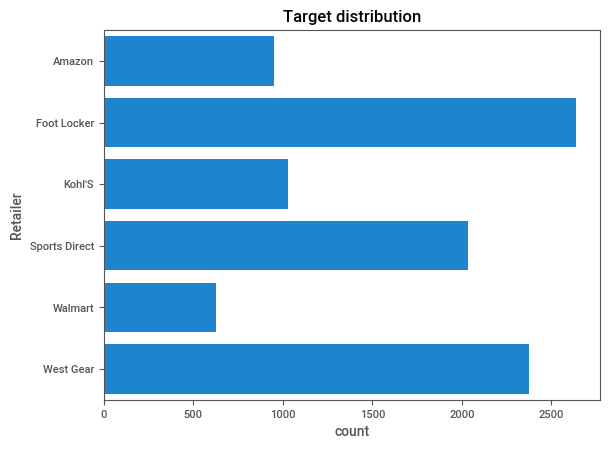

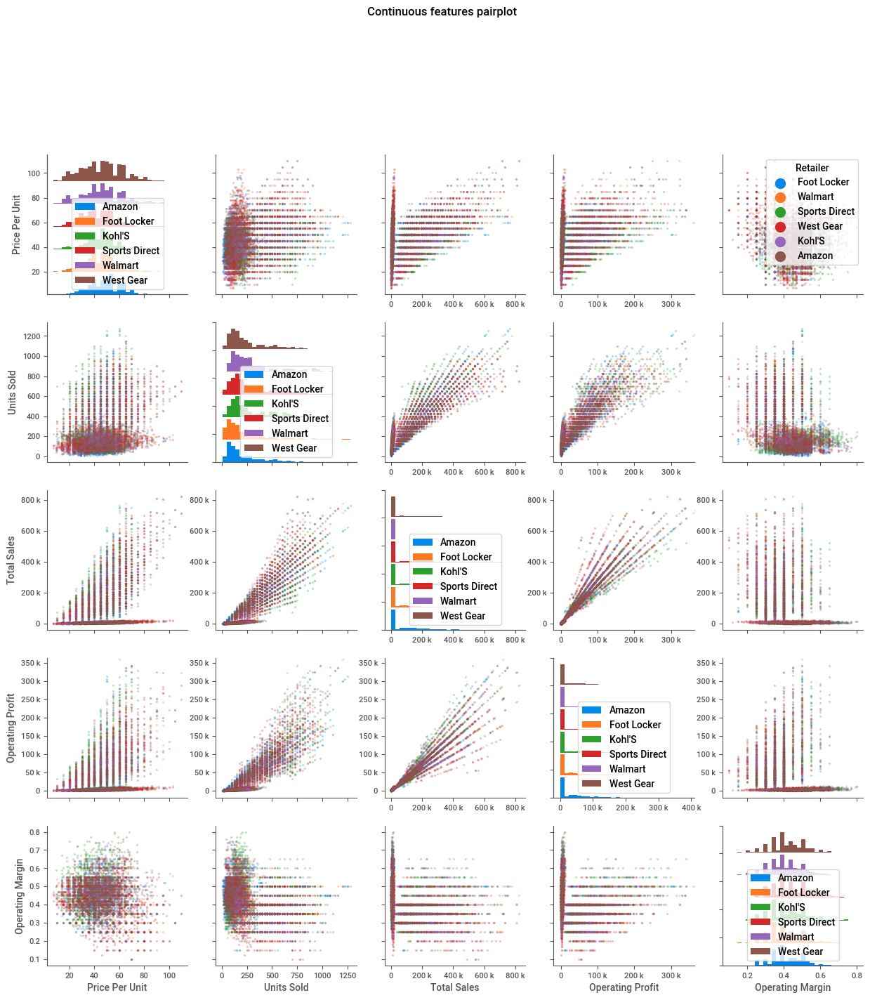

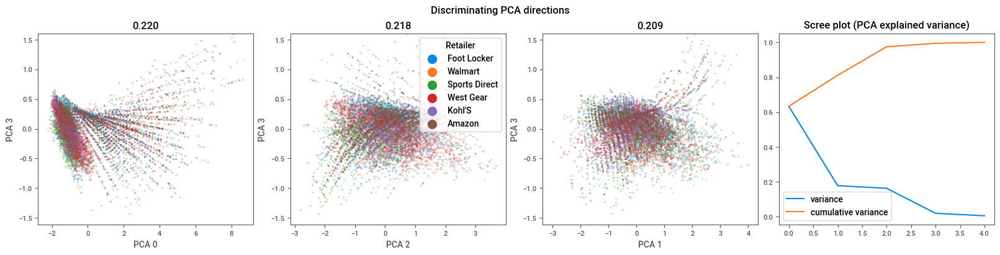

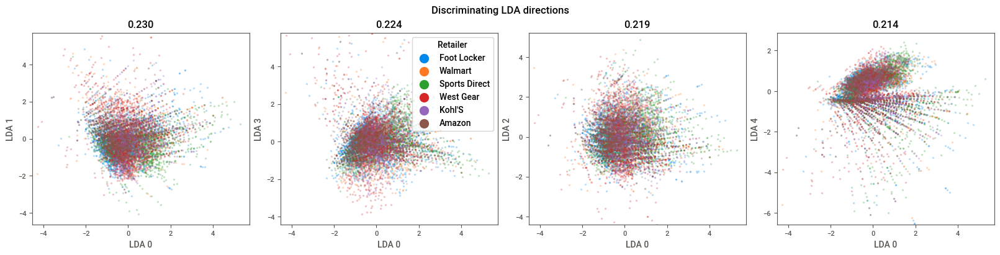

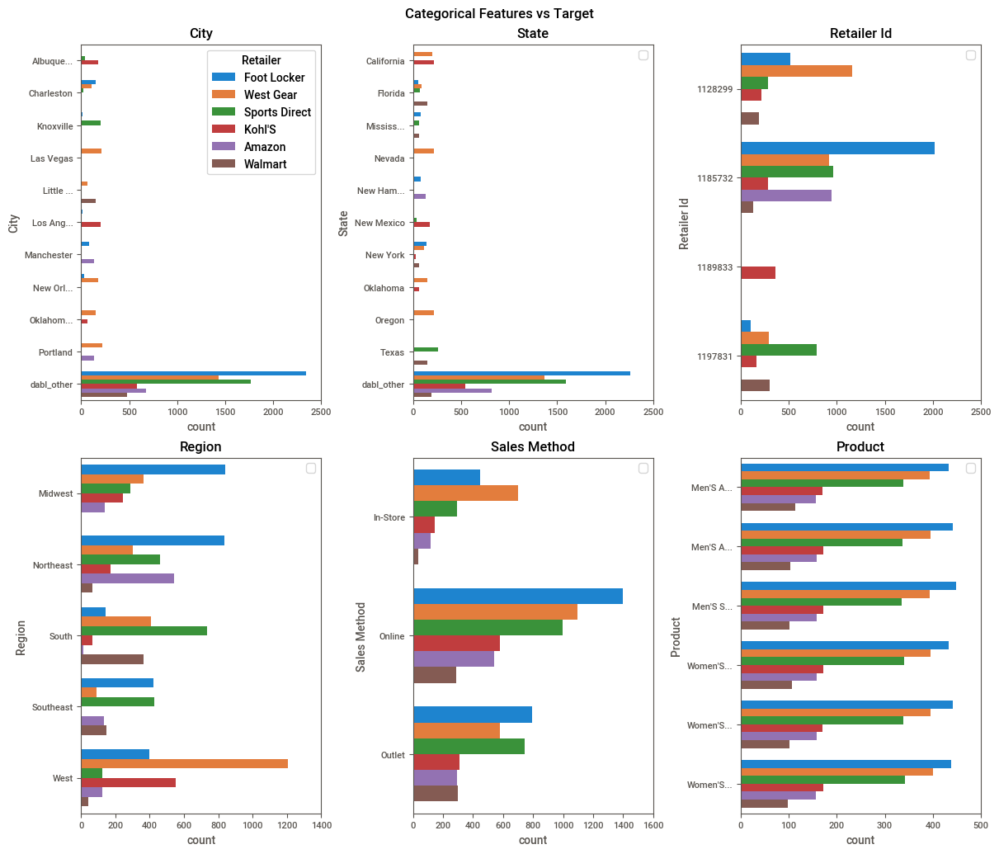

...

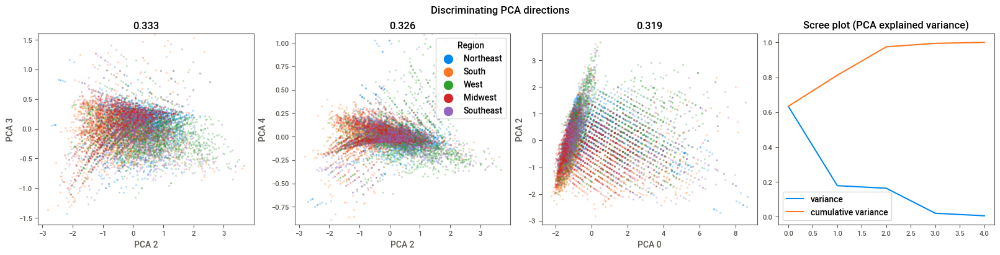

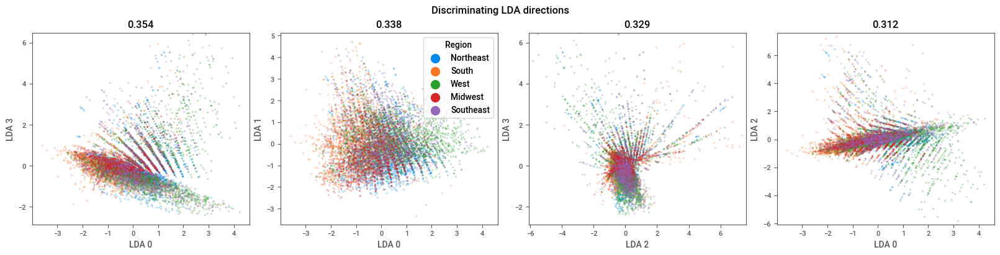

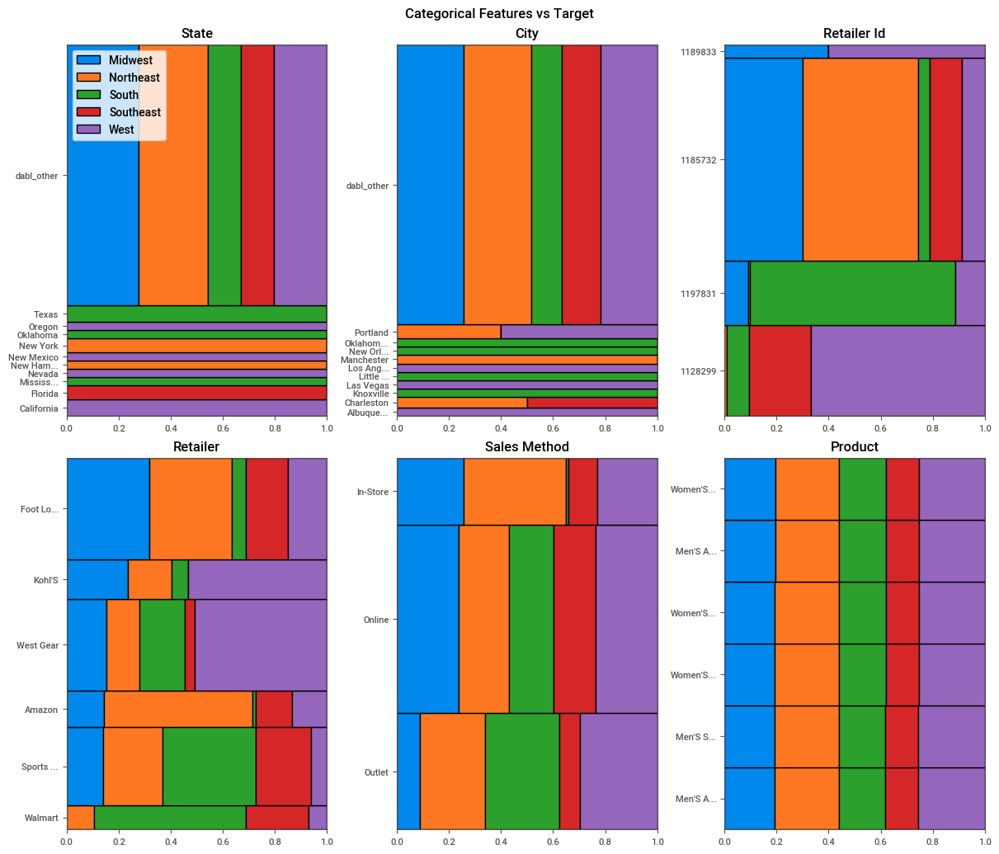

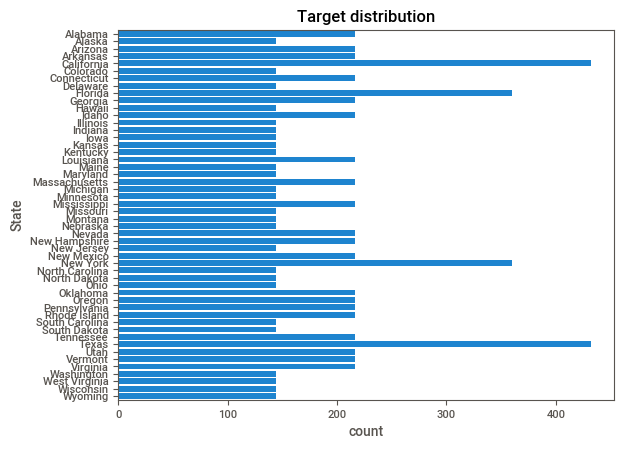

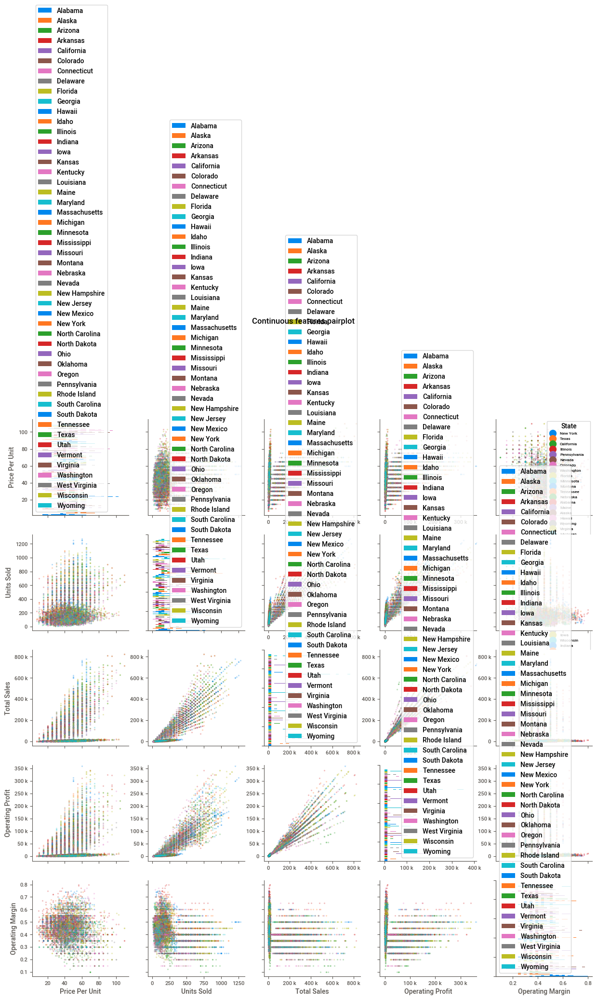

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.



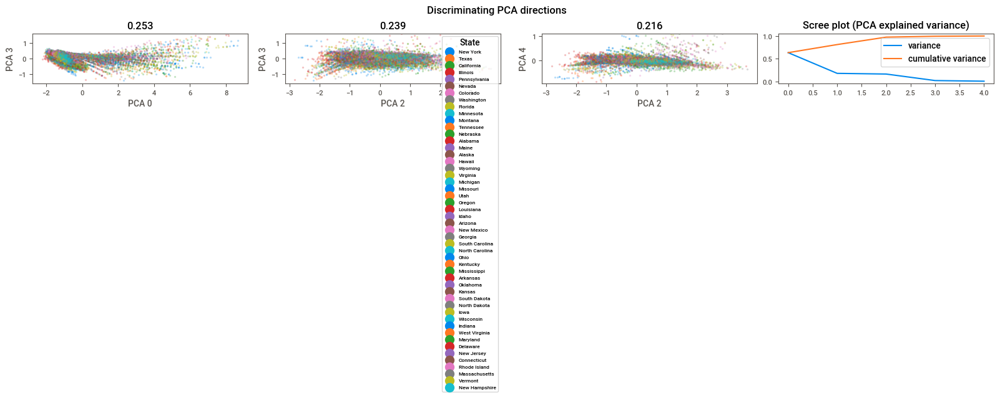

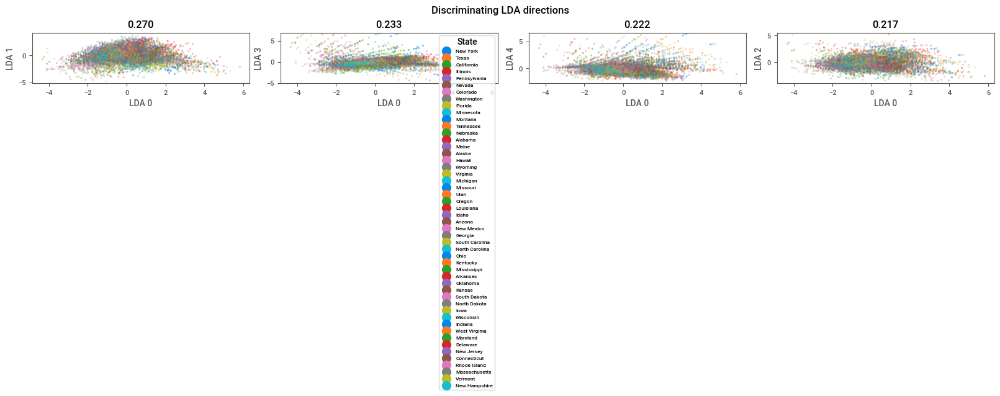

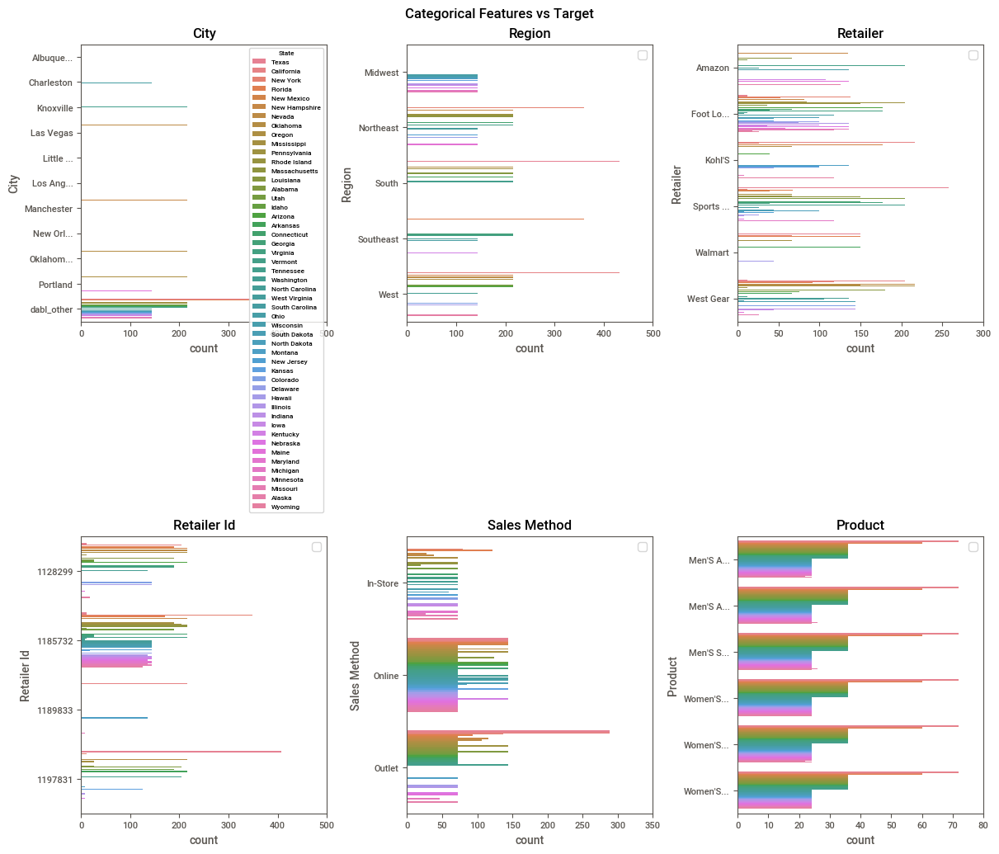

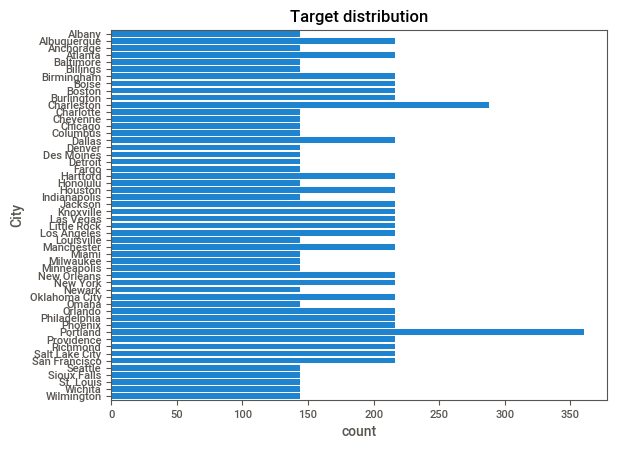

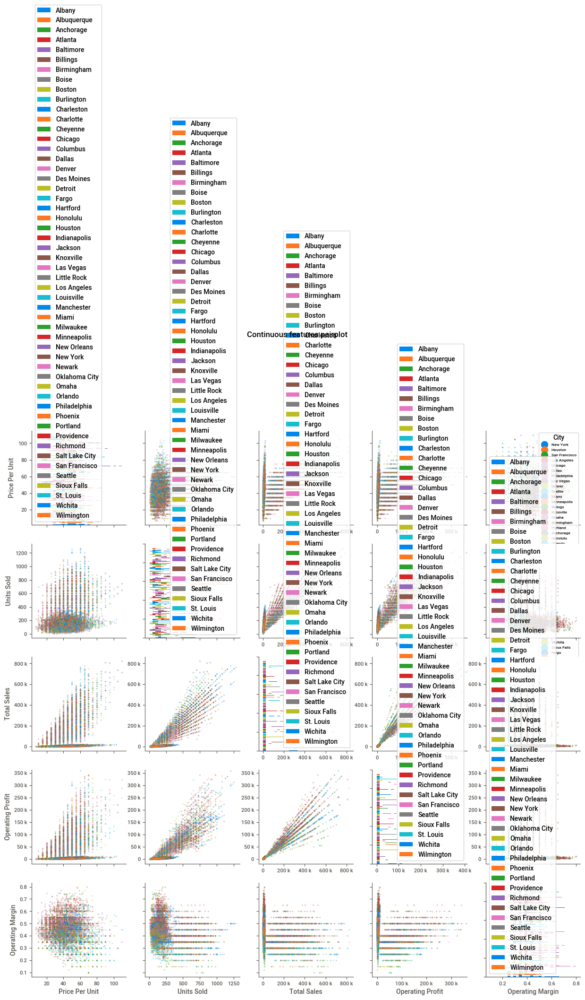

...

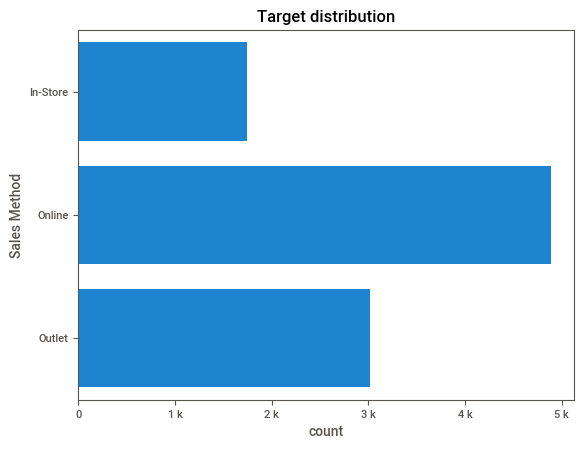

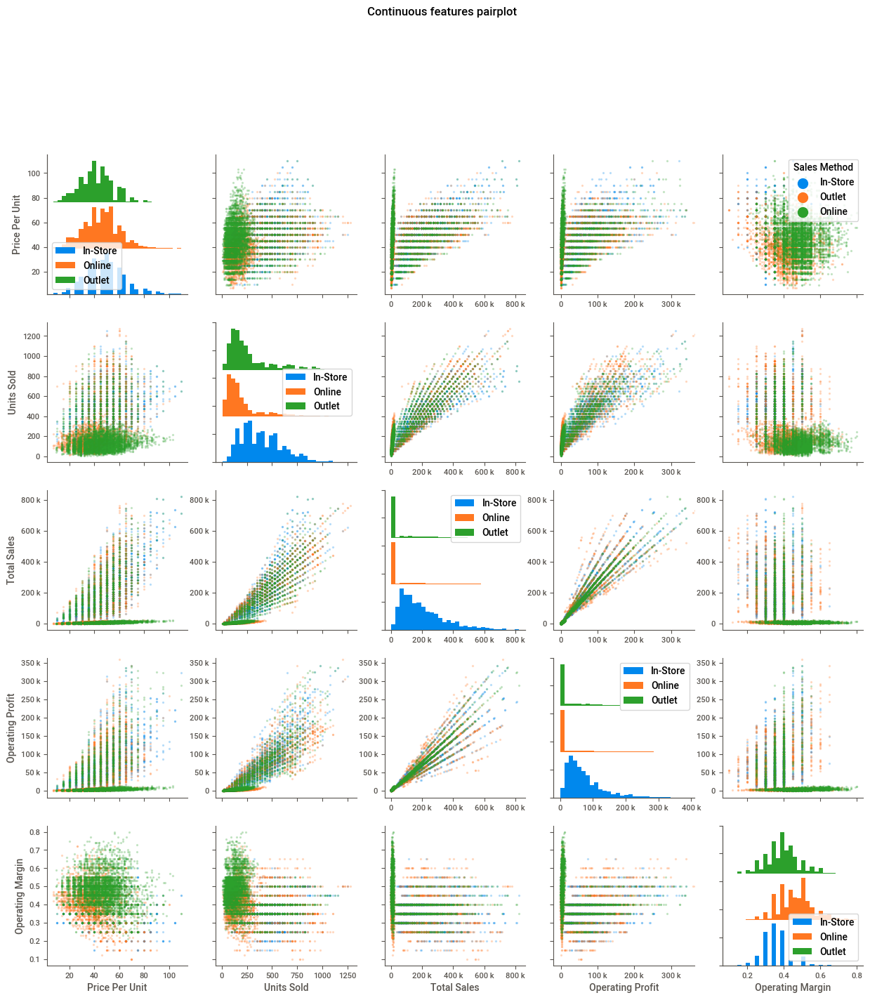

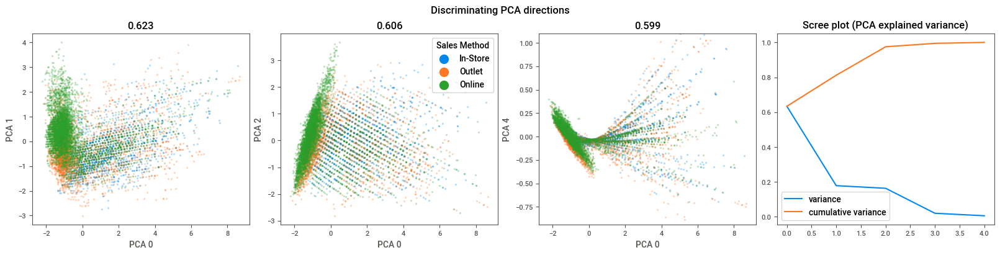

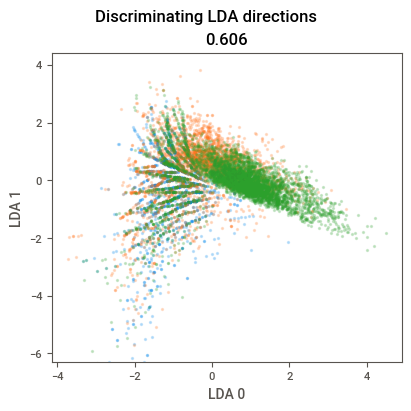

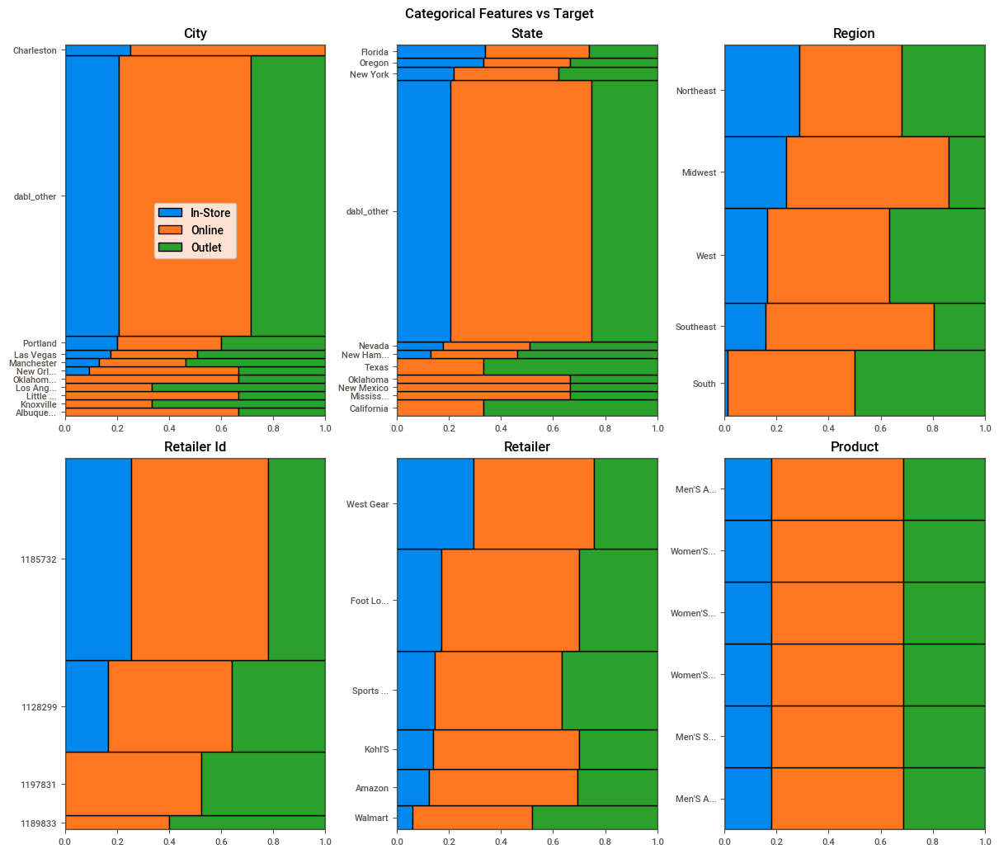

In [ ]:
for column in df.columns:
  try:
    dabl.plot(df, column)
  except:
    pass

In [ ]:
df_clean = dabl.clean(df, verbose=1)

Detected feature types:
continuous                  5
dirty_float                 0
low_card_int_ordinal        0
low_card_int_categorical    0
categorical                 7
date                        1
free_string                 0
useless                     0
dtype: int64


In [ ]:
types = dabl.detect_types(df_clean)
print(types)

                  continuous  dirty_float  low_card_int_ordinal  \
Retailer               False        False                 False   
Retailer Id            False        False                 False   
Invoice Date           False        False                 False   
Region                 False        False                 False   
State                  False        False                 False   
City                   False        False                 False   
Product                False        False                 False   
Price Per Unit          True        False                 False   
Units Sold              True        False                 False   
Total Sales             True        False                 False   
Operating Profit        True        False                 False   
Operating Margin        True        False                 False   
Sales Method           False        False                 False   

                  low_card_int_categorical  categorical   dat

### 06.07 Dataprep


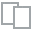
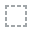
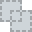
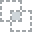
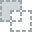
...
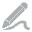
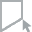
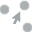
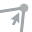
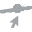

In [ ]:
plot(df)


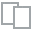
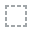
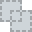
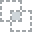
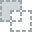
...
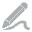
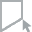
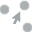
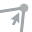
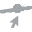

In [ ]:
 plot_correlation(df)

Computing isnull-9a347005319bf9ac68b22c5003d0ebca:   0%|          | 0/169 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/dask/core.py:127: RuntimeWarning:

invalid value encountered in divide




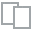
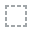
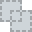
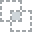
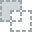
...
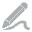
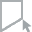
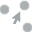
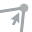
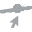

In [ ]:
plot_missing(df)

In [ ]:
df.columns

Index(['Retailer', 'Retailer Id', 'Invoice Date', 'Region', 'State', 'City',
       'Product', 'Price Per Unit', 'Units Sold', 'Total Sales',
       'Operating Profit', 'Operating Margin', 'Sales Method'],
      dtype='object')


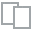
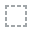
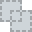
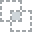
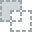
...
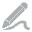
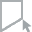
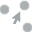
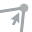
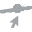

In [ ]:
plot(df, 'Price Per Unit')

### 06.08 Klib

In [ ]:
klib.corr_mat(df)

,Retailer Id,Price Per Unit,Units Sold,Total Sales,Operating Profit,Operating Margin
Retailer Id,1.00,-0.39,-0.00,-0.08,-0.03,0.22
Price Per Unit,-0.39,1.00,0.27,0.44,0.39,-0.14
Units Sold,-0.00,0.27,1.00,0.91,0.89,-0.31
Total Sales,-0.08,0.44,0.91,1.00,0.96,-0.36
Operating Profit,-0.03,0.39,0.89,0.96,1.00,-0.21
Operating Margin,0.22,-0.14,-0.31,-0.36,-0.21,1.00


<Axes: title={'center': 'Feature-correlation (pearson)'}>

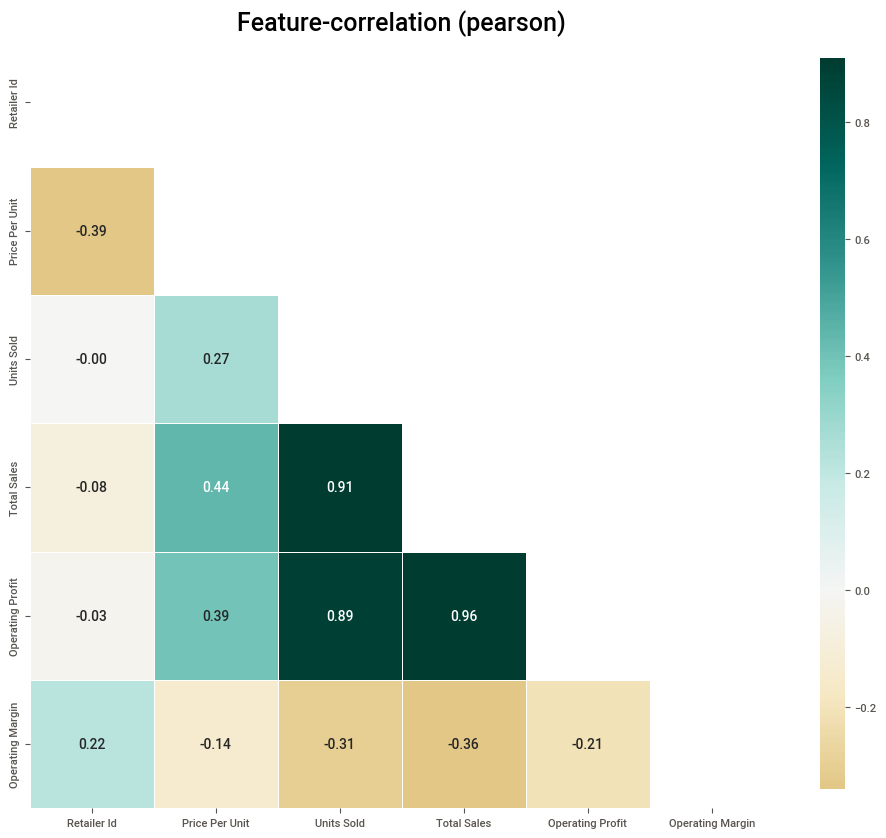

In [ ]:
klib.corr_plot(df)

<Axes: xlabel='Operating Margin', ylabel='Density'>

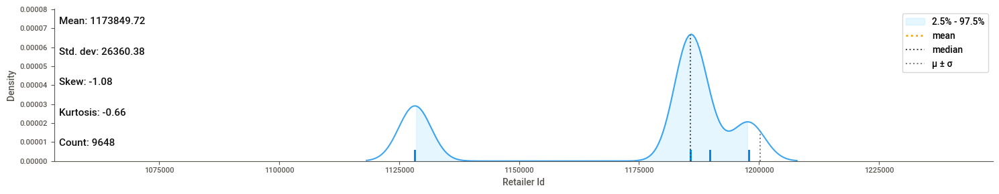

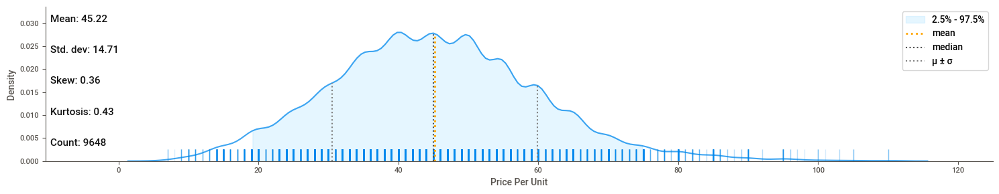

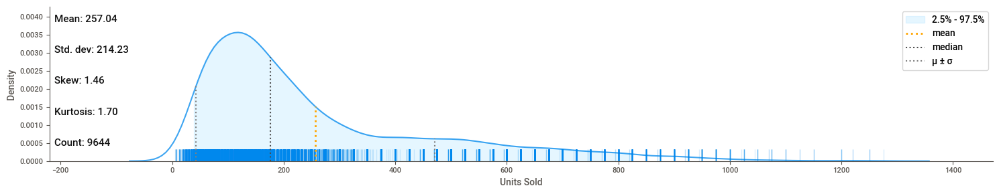

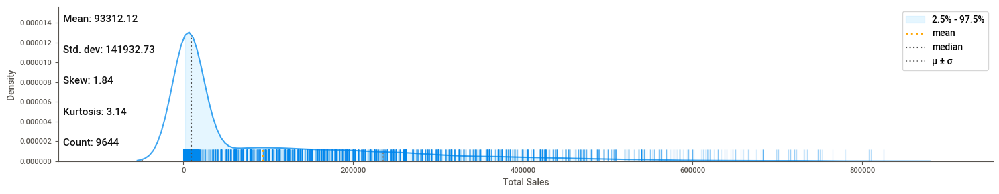

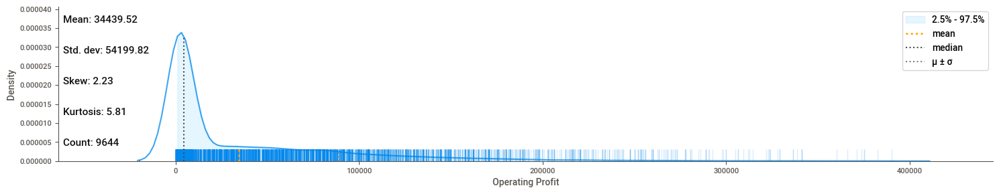

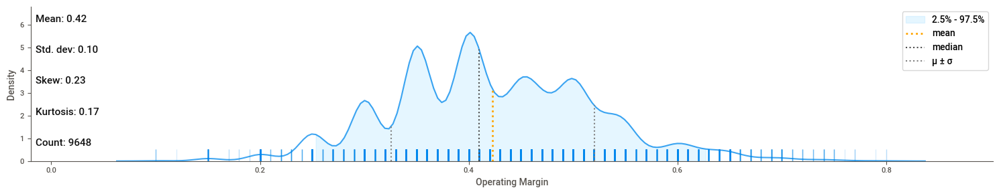

In [ ]:
klib.dist_plot(df)

### 06.09 Missingno

<Axes: >

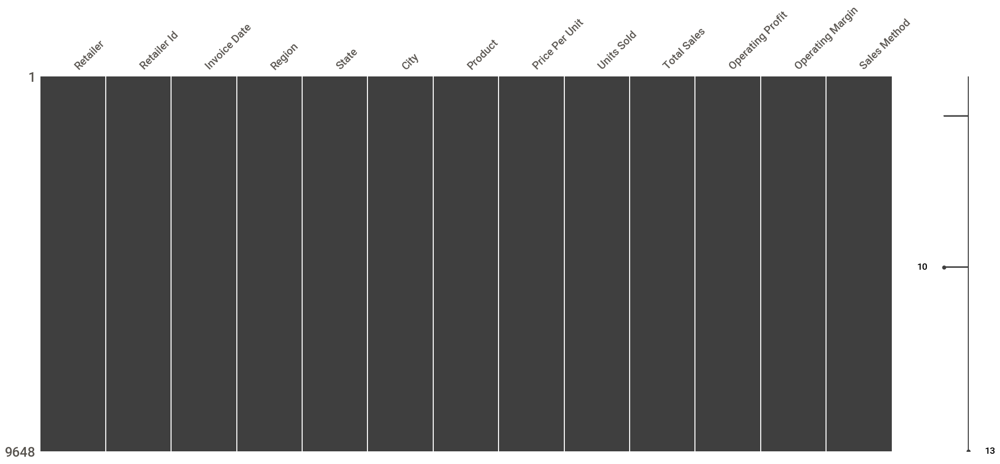

In [ ]:
msno.matrix(df)

<Axes: >

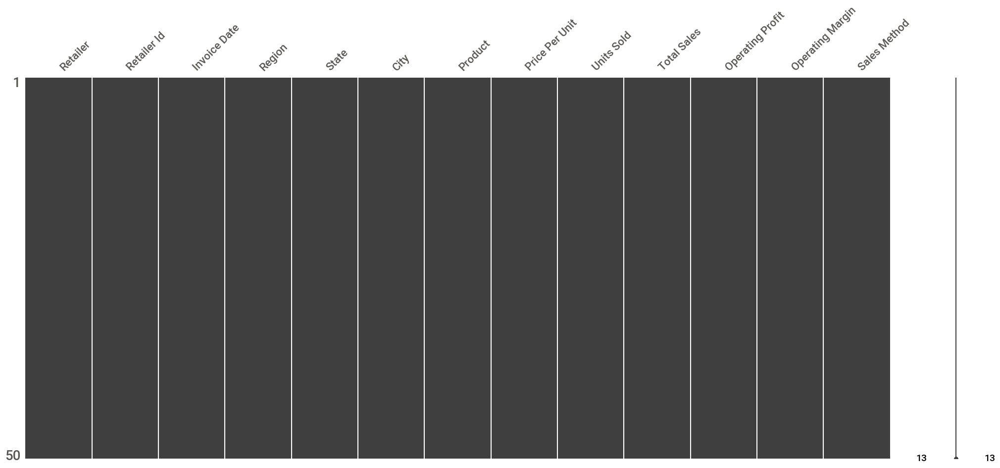

In [ ]:
msno.matrix(df.sample(50))

<Axes: >

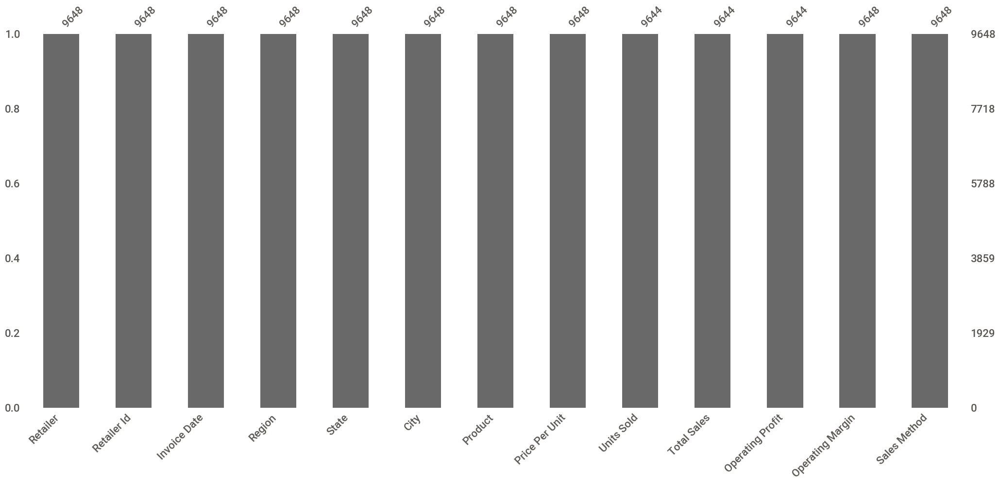

In [ ]:
msno.bar(df)

<Axes: >

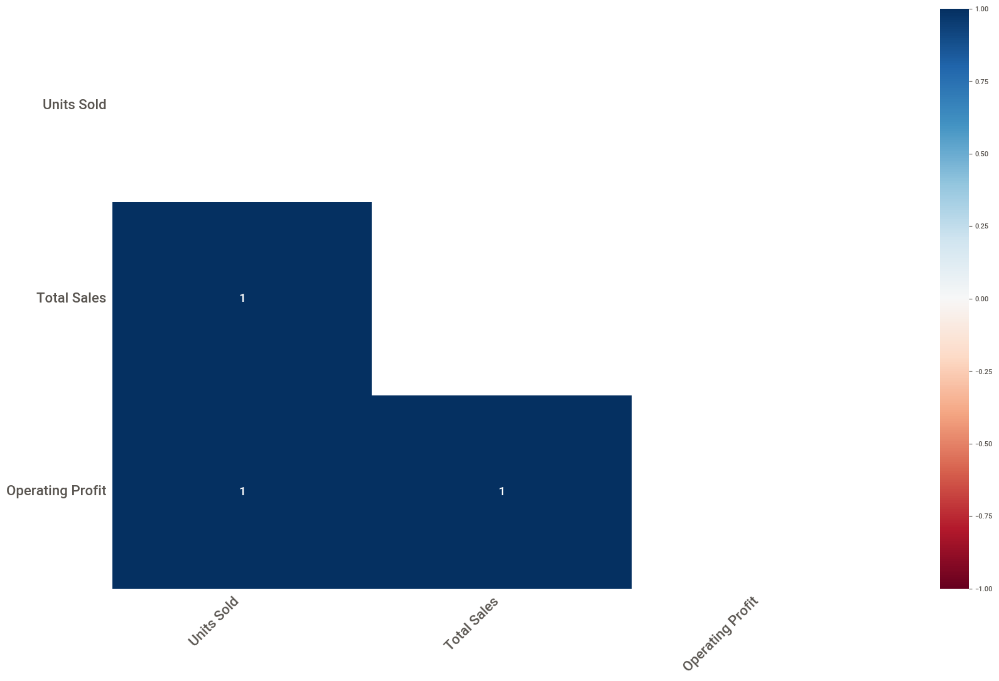

In [ ]:
msno.heatmap(df)